In [12]:
#importing all necessary packages
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd 
import seaborn as sns
import cv2
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tqdm import tqdm
import os

from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow.keras.applications import EfficientNetB1
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, TensorBoard, ModelCheckpoint
from sklearn.metrics import classification_report,confusion_matrix

import ipywidgets as widgets
import io
from PIL import Image
from IPython.display import display,clear_output
from warnings import filterwarnings

In [1]:
#importing content from the drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#giving training and testing path
training_path = '/content/drive/MyDrive/tumor_dataset/Training'
testing_path = '/content/drive/MyDrive/tumor_dataset/Testing'

In [ ]:
#knowing what folder(labels) exist
File=[]
for file in os.listdir(testing_path):
    File.append(file)
print(File)

['meningioma_tumor', 'glioma_tumor', 'pituitary_tumor', 'no_tumor']


In [ ]:
labels = ['pituitary_tumor', 'no_tumor', 'meningioma_tumor', 'glioma_tumor']

In [ ]:
#assigning the ground truth lables to the images in training and testing set
X_train = []
y_train = []

X_test = []
y_test = []

image_size = 150

for i in labels:
    folderPath = os.path.join(training_path,i)
    for j in tqdm(os.listdir(folderPath)):
        img = cv2.imread(os.path.join(folderPath,j))
        img = cv2.resize(img,(image_size, image_size))
        X_train.append(img)
        y_train.append(i)
        
for i in labels:
    folderPath = os.path.join(testing_path,i)
    for j in tqdm(os.listdir(folderPath)):
        img = cv2.imread(os.path.join(folderPath,j))
        img = cv2.resize(img,(image_size,image_size))
        X_test.append(img)
        y_test.append(i)
        
X_train = np.array(X_train)
y_train = np.array(y_train)

X_test = np.array(X_test)
y_test = np.array(y_test)

100%|██████████| 100/100 [00:01<00:00, 52.01it/s]


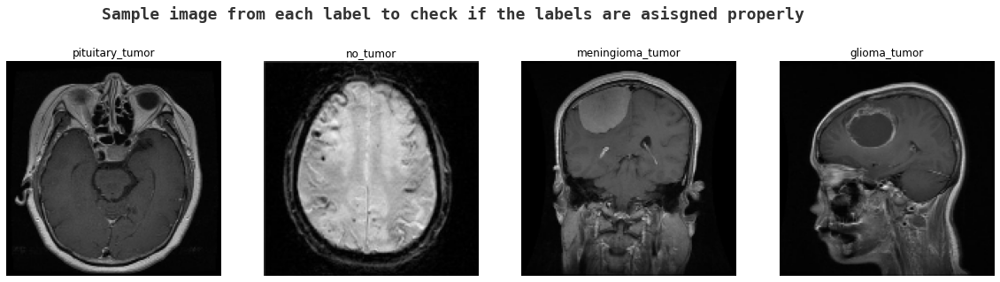

In [ ]:
#testing if the labels are properly assigned to the images
k=0
fig, ax = plt.subplots(1,4,figsize=(20,20))
fig.text(s='Sample image from each label to check if the labels are asisgned properly',size=18,fontweight='bold',
             fontname='monospace',y=0.62,x=0.2,alpha=0.8)
for i in labels:
    j=0
    while True :
        if y_train[j]==i:
            ax[k].imshow(X_train[j])
            ax[k].set_title(y_train[j])
            ax[k].axis('off')
            k+=1
            break
        j+=1

In [ ]:
#train-validation split 
X_train,X_val,y_train,y_val = train_test_split(X_train,y_train, test_size=0.1,random_state=1)

In [ ]:
#checking the train, validation, test sets' shapes
print(X_train.shape)
print(y_train.shape)

print(X_val.shape)
print(y_val.shape)

print(X_test.shape)
print(y_test.shape)

(2583, 150, 150, 3)
(2583,)
(287, 150, 150, 3)
(287,)
(394, 150, 150, 3)
(394,)


In [ ]:
#a sample check of the y label
print(y_train[0])

meningioma_tumor


In [ ]:
#changing the labels to categorical values using one hot encoding, so as to pass it to the model
y_train_new = []
for i in y_train:
  y_train_new.append(labels.index(i))
y_train = y_train_new
y_train = tf.keras.utils.to_categorical(y_train)

y_val_new = []
for i in y_val:
  y_val_new.append(labels.index(i))
y_val = y_val_new
y_val = tf.keras.utils.to_categorical(y_val)

y_test_new = []
for i in y_test:
  y_test_new.append(labels.index(i))
y_test = y_test_new
y_test = tf.keras.utils.to_categorical(y_test)

print(y_train)
print(y_val)
print(y_test)

[[0. 0. 1. 0.]
 [0. 0. 0. 1.]
 [1. 0. 0. 0.]
 ...
 [0. 1. 0. 0.]
 [1. 0. 0. 0.]
 [0. 1. 0. 0.]]
[[0. 0. 0. 1.]
 [0. 0. 0. 1.]
 [0. 0. 1. 0.]
 ...
 [1. 0. 0. 0.]
 [0. 0. 1. 0.]
 [0. 1. 0. 0.]]
[[1. 0. 0. 0.]
 [1. 0. 0. 0.]
 [1. 0. 0. 0.]
 ...
 [0. 0. 0. 1.]
 [0. 0. 0. 1.]
 [0. 0. 0. 1.]]


In [ ]:
#efficient net is the CNN architecture used
effnet = EfficientNetB1(weights='imagenet',include_top=False,input_shape=(image_size,image_size,3))

27033600/27018416 [==============================] - 0s 0us/step


In [ ]:
model = effnet.output
model = tf.keras.layers.GlobalAveragePooling2D()(model)
model = tf.keras.layers.Dropout(rate=0.5)(model)
model = tf.keras.layers.Dense(4,activation='softmax')(model) #output has 4 classes 
model = tf.keras.models.Model(inputs=effnet.input, outputs = model)

In [ ]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling (Rescaling)          (None, 150, 150, 3)  0           ['input_1[0][0]']                
                                                                                                  
 normalization (Normalization)  (None, 150, 150, 3)  7           ['rescaling[0][0]']              
                                                                                                  
 stem_conv_pad (ZeroPadding2D)  (None, 151, 151, 3)  0           ['normalization[0][0]']      

In [ ]:
model.compile(loss='categorical_crossentropy',optimizer = 'Adam', metrics= ['accuracy'])

In [ ]:
tensorboard = TensorBoard(log_dir = 'logs')
checkpoint = ModelCheckpoint("effnet_tumor_class.h5",monitor="val_accuracy",save_best_only=True,mode="auto",verbose=1)
reduce_lr = ReduceLROnPlateau(monitor = 'val_accuracy', factor = 0.3, patience = 2, min_delta = 0.001,
                              mode='auto',verbose=1)
#in order to avoid overfitting
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', mode = 'min', patience=2)

In [ ]:
#initiating the training
his = model.fit(X_train,y_train,validation_data = (X_val,y_val) , epochs = 25, verbose=1, batch_size=32,
                   callbacks=[tensorboard,checkpoint,reduce_lr, early_stopping])

Epoch 1/25
81/81 [==============================] - ETA: 0s - loss: 0.4776 - accuracy: 0.8196
Epoch 1: val_accuracy improved from -inf to 0.74216, saving model to effnet_tumor_class.h5
81/81 [==============================] - 72s 508ms/step - loss: 0.4776 - accuracy: 0.8196 - val_loss: 1.2482 - val_accuracy: 0.7422 - lr: 0.0010
Epoch 2/25
81/81 [==============================] - ETA: 0s - loss: 0.1861 - accuracy: 0.9346
Epoch 2: val_accuracy improved from 0.74216 to 0.88850, saving model to effnet_tumor_class.h5
81/81 [==============================] - 37s 452ms/step - loss: 0.1861 - accuracy: 0.9346 - val_loss: 0.3150 - val_accuracy: 0.8885 - lr: 0.0010
Epoch 3/25
81/81 [==============================] - ETA: 0s - loss: 0.1150 - accuracy: 0.9636
Epoch 3: val_accuracy did not improve from 0.88850
81/81 [==============================] - 35s 431ms/step - loss: 0.1150 - accuracy: 0.9636 - val_loss: 0.7425 - val_accuracy: 0.8780 - lr: 0.0010
Epoch 4/25
81/81 [=============================

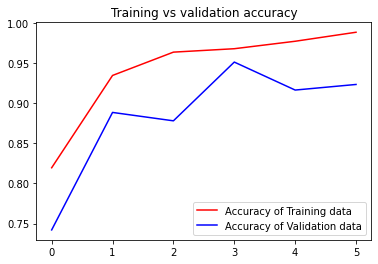

<Figure size 432x288 with 0 Axes>

In [ ]:
#plotting the accuracy curves
get_acc = his.history['accuracy']
value_acc = his.history['val_accuracy']
get_loss = his.history['loss']
validation_loss = his.history['val_loss']

epochs = range(len(get_acc))
plt.plot(epochs, get_acc, 'r', label='Accuracy of Training data')
plt.plot(epochs, value_acc, 'b', label='Accuracy of Validation data')
plt.title('Training vs validation accuracy')
plt.legend(loc=0)
plt.figure()
plt.show()

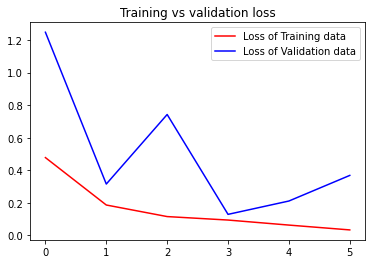

<Figure size 432x288 with 0 Axes>

In [ ]:
#plotting the loss curves
epochs = range(len(get_loss))
plt.plot(epochs, get_loss, 'r', label='Loss of Training data')
plt.plot(epochs, validation_loss, 'b', label='Loss of Validation data')
plt.title('Training vs validation loss')
plt.legend(loc=0)
plt.figure()
plt.show()

In [ ]:
#predictions on the test set
pred = model.predict(X_test)
pred = np.argmax(pred,axis=1)
y_test_new = np.argmax(y_test,axis=1)

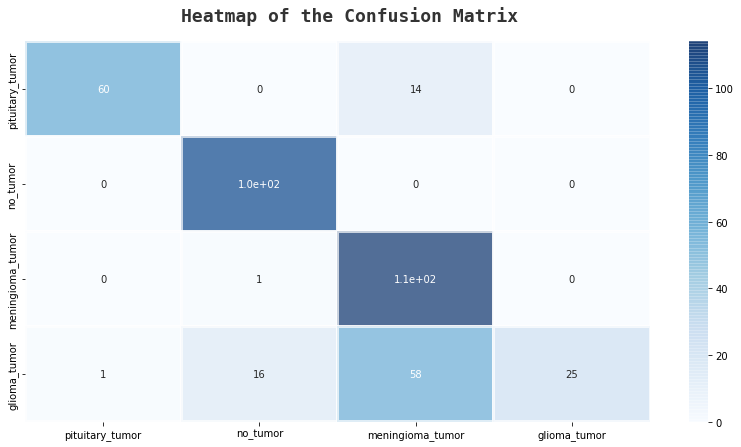

In [ ]:
#comparing the predictions of the model on the test set with the ground truth of the test set
fig,ax=plt.subplots(1,1,figsize=(14,7))
sns.heatmap(confusion_matrix(y_test_new,pred),ax=ax,xticklabels=labels,yticklabels=labels,annot=True,
  cmap="Blues",alpha=0.7,linewidths=2)
fig.text(s='Heatmap of the Confusion Matrix',size=18,fontweight='bold',
             fontname='monospace',y=0.92,x=0.28,alpha=0.8)

plt.show()

In [ ]:
print(classification_report(y_test_new,pred)) 

              precision    recall  f1-score   support

           0       0.98      0.81      0.89        74
           1       0.86      1.00      0.93       105
           2       0.61      0.99      0.76       115
           3       1.00      0.25      0.40       100

    accuracy                           0.77       394
   macro avg       0.86      0.76      0.74       394
weighted avg       0.85      0.77      0.74       394



In [ ]:
#sample prediction
image_size =150
path = '/content/drive/MyDrive/tumor_dataset/Testing/no_tumor/image(1).jpg'

img = cv2.imread(path)
img = cv2.resize(img,(image_size,image_size))

prediction_image=np.array(img)
prediction_image= np.expand_dims(img, axis=0)
reverse_mapping={0:'pituitary_tumor', 1:'no_tumor', 2:'meningioma_tumor', 3:'glioma_tumor'}

def mapper(value):
    return reverse_mapping[value]

prediction=model1.predict(prediction_image)
value=np.argmax(prediction)
move_name=mapper(value)
print("Prediction is: {}.".format(move_name))

Prediction is: no_tumor.


RUNNING THE INFERENCE.PY AND SALIENCE.PY USING CMD LINE ARGS


In [13]:
!python /content/drive/MyDrive/tumor_classification/inference.py \
-weights-path '/content/drive/MyDrive/tumor_classification/effnet_tumor_class.h5' \
-input-image-path '/content/drive/MyDrive/tumor_dataset/Testing/no_tumor/image(1).jpg'

Command Line Args: Namespace(input_image_path='/content/drive/MyDrive/tumor_dataset/Testing/no_tumor/image(10).jpg', weights_path='/content/drive/MyDrive/tumor_classification/effnet_tumor_class.h5')
2022-03-22 14:25:44.674136: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
model_fetched is :  <keras.engine.functional.Functional object at 0x7f4240d478d0>

Prediction is: no_tumor.


Command Line Args: Namespace(input_image_path='/content/drive/MyDrive/tumor_dataset/Testing/no_tumor/image(1).jpg', weights_path='/content/drive/MyDrive/tumor_classification/effnet_tumor_class.h5')
model_fetched is :  <keras.engine.functional.Functional object at 0x7f9420aff950>


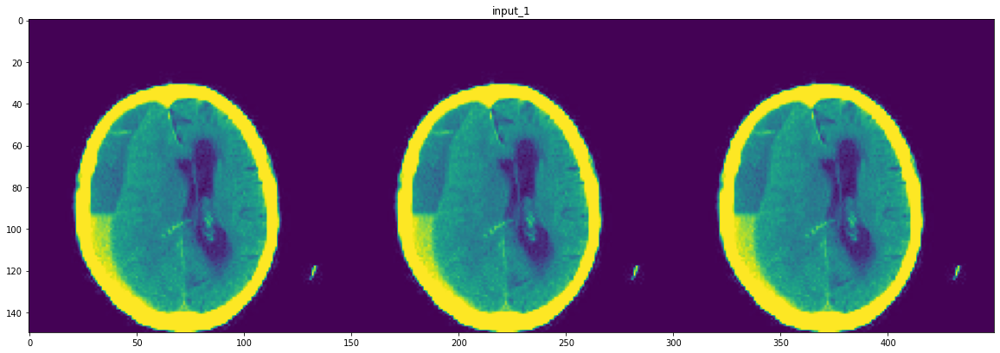

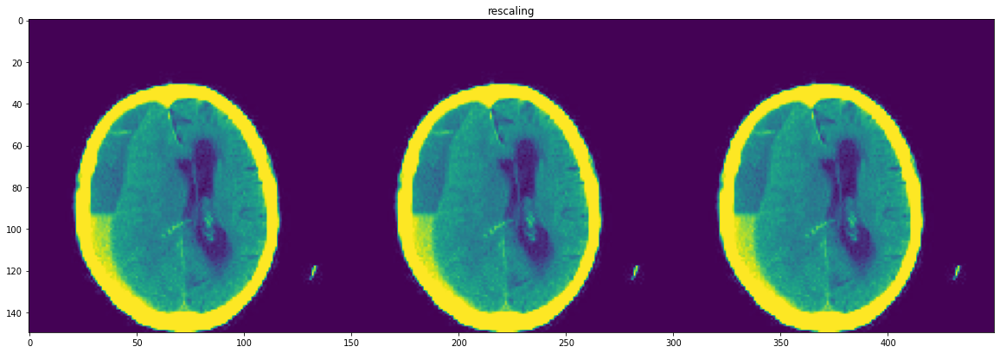

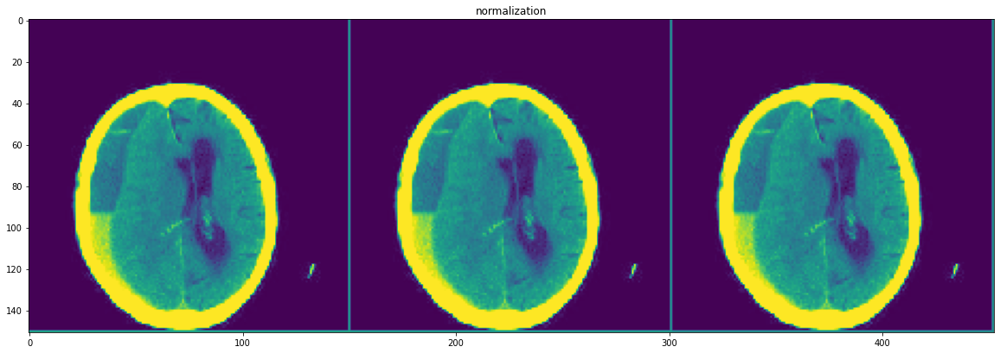

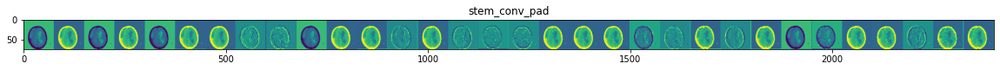

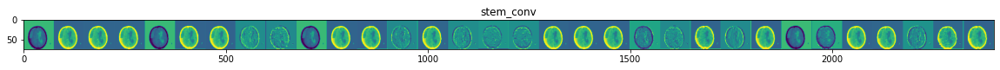

...

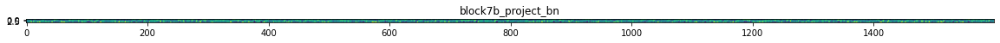

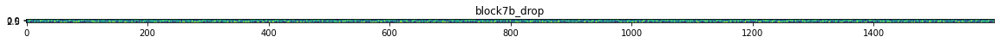

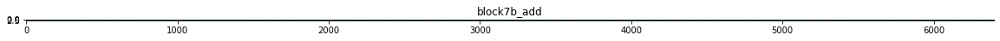

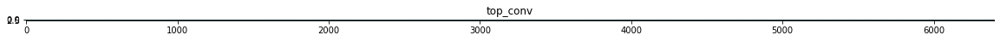

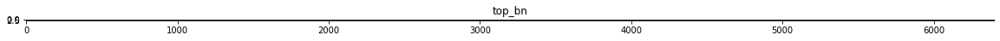

In [2]:
%run /content/drive/MyDrive/tumor_classification/salience_map.py \
-weights-path '/content/drive/MyDrive/tumor_classification/effnet_tumor_class.h5' \
-input-image-path '/content/drive/MyDrive/tumor_dataset/Testing/no_tumor/image(1).jpg'

Command Line Args: Namespace(input_image_path='/content/drive/MyDrive/tumor_dataset/Testing/glioma_tumor/image(100).jpg', weights_path='/content/drive/MyDrive/tumor_classification/effnet_tumor_class.h5')
model_fetched is :  <keras.engine.functional.Functional object at 0x7f72ba065d50>


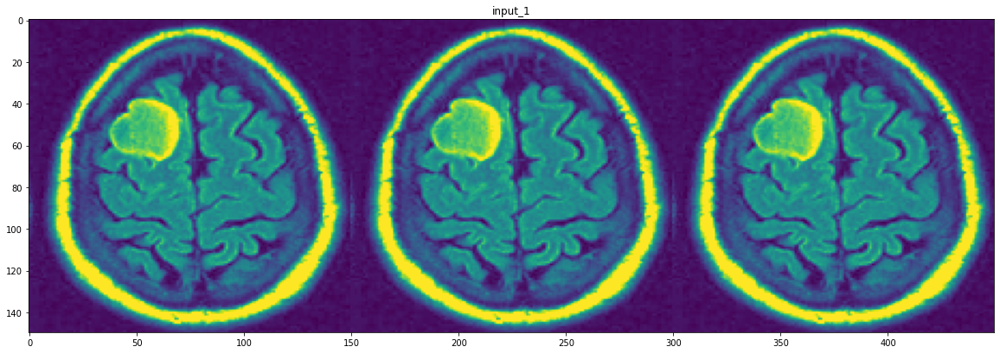

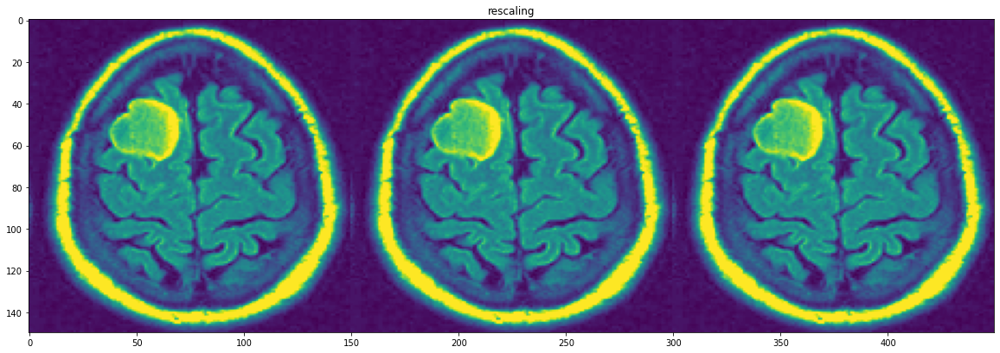

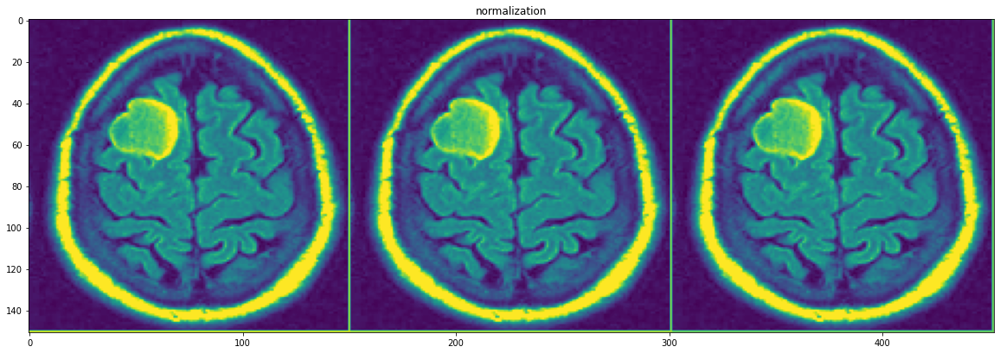

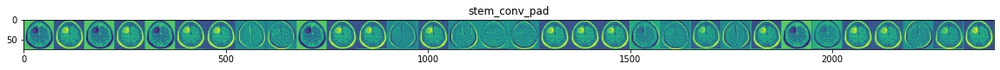

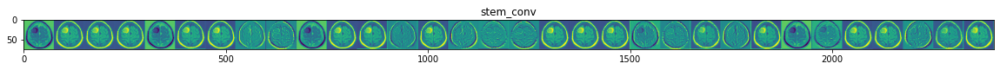

...

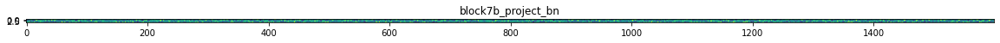

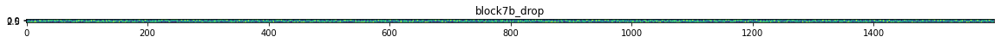

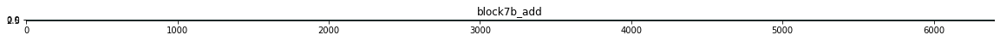

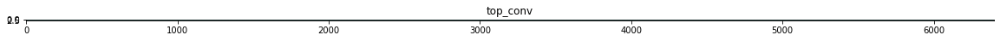

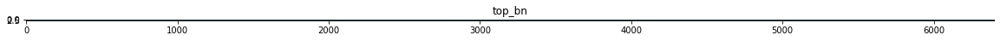

In [12]:
%run /content/drive/MyDrive/tumor_classification/salience_map.py \
-weights-path '/content/drive/MyDrive/tumor_classification/effnet_tumor_class.h5' \
-input-image-path '/content/drive/MyDrive/tumor_dataset/Testing/glioma_tumor/image(100).jpg'